# 📊 Time Series Analysis: Electricity Price Forecasting

## Project Overview
This notebook contains a comprehensive analysis and forecasting of electricity prices using various time series models. The project explores different approaches to predict future electricity prices based on historical data.

### 📋 Project Structure
1. **Data Loading & Preprocessing**
2. **Exploratory Data Analysis (EDA)**
3. **Feature Engineering**
4. **Model Development**
   - Baseline Models
   - Statistical Models (ARIMA, SARIMA)
5. **Forecasting & Results**

### 🎯 Objectives
- Analyze historical electricity price patterns
- Develop forecasting models
- Compare model performance
- Generate future price predictions

### 📊 Data Source
- **Dataset**: Price of Weighted Day-Ahead-Futures for electricity for the Germany/Luxembourg grid
- **Time Period**: 01.01.2018 to 13.09.2025
- **Frequency**: Hourly
- **Source**: smard.de

### 🛠️ Technologies Used
- Python 3.x
- Pandas, NumPy
- Statsmodels, pmdarima
- Scikit-learn
- Plotly/Matplotlib

### 📝 Note
This notebook is part of the IBM Time Series Analysis course final project.

---

*Last Updated: September 2025*

In [ ]:
# install packages - i am running a python 3.10 environment
# in my case, all packages are already installed - uncomment if needed.
# %pip install statsforecast
# %pip install pmdarima
# %pip install prophet
# %pip install statsmodels
# %pip install plotly



In [2]:
# import packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#import seaborn as sns
#from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
#from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_squared_error
import plotly.express as px 
import plotly.graph_objects as go
import prophet
#from statsforecast.adapters.prophet import AutoARIMAProphet 
from statsmodels.tsa.seasonal import MSTL
#from keras.models import Sequential
#from keras.layers import Dense, SimpleRNN, LSTM
import pmdarima as pm

import warnings
warnings.filterwarnings("ignore")

/Users/bes/opt/anaconda3/envs/tf_env/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
# some functions we can use later
def fix_daylight_saving_jumps(df: pd.DataFrame, time_column: str = 'Date') -> pd.DataFrame:
    """ This function fixes the daylight saving time jumps (i.e. the time before and after the jump is duplicated or a two hour gap is inserted) 
    in a time series column. Assumption: The time series is hourly. (might be more versatile)"""
    
    df_out = df.copy()
    series = df_out['Date']
    df_out['time_adjust'] = 0
    is_jump_ahead = series.diff() > pd.Timedelta(hours=1)
    is_jump_back = series.duplicated()
    df_out.loc[is_jump_ahead,'time_adjust'] = -1
    df_out.loc[is_jump_back,'time_adjust'] = 1
    df_out['time_adjust'] = df_out['time_adjust'].cumsum()
    df_out['time_adjust'] = pd.to_timedelta(df_out['time_adjust'], unit='h')
    df_out['Date'] = df_out['Date'] + df_out['time_adjust']
    df_out = df_out.drop(columns=['time_adjust'])

    return df_out
    
def fourier_analyses(df, unit = "seconds"):
    """ fouriertransforms all time traces in the data frame. 
    Works best data frame with datetime index with a frequency. 
    Returns correctly scaled spectral densities of all columns. 
    Warning: Currently phase sign is engineering convention.
    """
    if isinstance(df.index, pd.DatetimeIndex):
        time = df.index
    else :
        time = np.arange(len(df))
        print("Warning: time index not found, using positional index. Frequency is positional, not physical")
    timespan = time[-1] - time[0]
    if unit == "seconds" or unit =='s':
        timespan = timespan.total_seconds()
    elif unit == "hours" or unit =='h':
        timespan = timespan.total_seconds()/3600
        print("Timespan in hours: ", timespan)
    elif unit == "years" or unit =='y' or unit =='a':
        from dateutil.relativedelta import relativedelta
        timespan = relativedelta(time[-1], time[0]).years
    
    f_df = pd.DataFrame()
    f_df[f'freq [1/{unit}]'] = np.arange(len(df)//2+1)/timespan 
    for col in df.columns:
        f_col = np.fft.fft(df[col])
        f_col = f_col[0:len(f_col)//2+1]/timespan*2
        f_col[0] = f_col[0]/2
        f_df[f"f_{col}*{unit}"] = f_col
    f_df = f_df.set_index(f"freq [1/{unit}]")

    import plotly.express as px
    df_ampli = f_df.copy()
    for col in f_df.columns:
        df_ampli[col] = np.abs(f_df[col])
    df_ampli = df_ampli.reset_index()
    #amplitude_spectrum = px.scatter(data_frame = df_ampli, x=f"freq/{unit}", y=df_ampli.columns)
    #amplitude_spectrum.show()
    return f_df, timespan

# how to get the variance "homogegenised"
class Transform_For_Variance_Homogenisation:
    """
    This class is used to transform a time series so that the variance is homogenised.
    It does this by first offsetting the series so that the minimum value is 0. 
    Then offsetting it by the range of the series.
    Then it applies a log transformation. 
    The transformer needs to be an object, because it needs to store the values for the forward transformation to enable back transformation.
    """
    def __init__(self, original_df):
        if len(original_df.columns) > 1:
            raise ValueError("original_df must have only one column")
        self.original_df = original_df
        self.original_series = original_df[original_df.columns[0]]
        self.original_min = self.original_series.min()
        self.original_max = self.original_series.max()
    def log_transform(self):
        offset_series = self.original_series - self.original_min + (self.original_max-self.original_min)
        self.log_transformed_series = np.log(offset_series)
        intermediate_df = self.original_df.copy()
        intermediate_df[intermediate_df.columns[0]] = self.log_transformed_series
        self.log_transformed_df = intermediate_df
        return self.log_transformed_df

    def get_log_transformed_series(self):
        return self.log_transformed_series
    def get_log_transformed_df(self):
        return self.log_transformed_df
    def get_original_series(self):
        return self.original_series
    def invert_log_transform(self, transformed_series):
        return np.exp(transformed_series) + self.original_min - (self.original_max-self.original_min)

    def set_seasonal_decomp(self, seasonal_decomp, periods = None):
        if periods is not None:
            seasonal_decomp = seasonal_decomp.rename(columns = {"seasonal_"+str(period): str(period) for period in periods})
        self.seasonal_decomp = seasonal_decomp
    def get_seasonal_decomp(self):
        return self.seasonal_decomp
    def set_trend(self, trend):
        self.trend = trend
    def get_trend(self):
        return self.trend

    def extrapolate(self, start, horizon = 1):
        if self.seasonal_decomp is None:
            raise ValueError("seasonal_decomp must be set")
        if self.trend is None:
            raise ValueError("trend must be set")
        if isinstance(start, pd.Timestamp):
            start = self.original_series.index.get_loc(start)
        
        start_value = self.original_series.iloc[start]
        slope = (self.trend.iloc[start+horizon-1] - self.trend.iloc[start-1])/(horizon)
        series_extrapolated = self.original_series.iloc[start-1: start+horizon].copy()
               
        try:
            seasons = self.seasonal_decomp.columns
            seasons_number = [int(season) for season in seasons]
        except:
            raise ValueError("seasonal_decomp must have integer columns")
        
        for i in range(1,horizon+1,1):
            seasonal_value = sum(
                [self.seasonal_decomp[seasons[j]].iloc[start-1-seasons_number[j]+i%seasons_number[j]]-self.seasonal_decomp[seasons[j]].iloc[start-1] 
                for j in range(len(seasons))])
            series_extrapolated.iloc[i] = start_value + slope*i + seasonal_value
        return series_extrapolated
    

       
def rmse(df, true_column = 'Price_DE [€/MWh]', pred_column = 'Price_DE [€/MWh]_pred'): 
    """ Returns the root mean squared error of the true and predicted columns of a data frame"""
    error = np.sqrt(mean_squared_error(df[true_column], df[pred_column]))
    return error

def cross_validate(series,horizon,start,step_size,order = (1,0,0),seasonal_order = (0,0,0,0),trend=None):
    '''
    Function to determine in and out of sample testing of arima model    
    
    arguments
    ---------
    series (seris): time series input
    horizon (int): how far in advance forecast is needed
    start (int): starting location in series
    step_size (int): how often to recalculate forecast
    order (tuple): (p,d,q) order of the model
    seasonal_order (tuple): (P,D,Q,s) seasonal order of model
    
    Returns
    -------
    DataFrame: gives fcst and actuals with date of prediction
    '''
    fcst = []
    actual = []
    date = []
    for i in range(start,len(series)-horizon,step_size):
        model = SARIMAX(series.iloc[:i+1], #only using data through to and including start 
                                order=order, 
                                seasonal_order=seasonal_order, 
                                trend=trend).fit()
        fcst.append(model.forecast(steps = horizon)[-1]) #forecasting horizon steps into the future
        actual.append(series.iloc[i+horizon]) # comparing that to actual value at that point
        date.append(series.index[i+horizon]) # saving date of that value
    return pd.DataFrame({'fcst':fcst,'actual':actual},index=date)
    

In [4]:
# load data 
df_raw = pd.read_csv('Gro_handelspreise_201810010000_202509140000_Stunde.csv', delimiter=';', decimal=',') # reading in. German format (decimal comma)
# raw data contains periods ("Date_from" to "Date_to" and Prices for most European countries/grid regions)

# check data
#df_raw.head()
print(df_raw.info())
#df_raw.describe()

# first, lets only look at the German (and Luxemburg) prices. Convert the "Date from" column into a date-time index

df_DE = df_raw[['Datum von', 'Deutschland/Luxemburg [€/MWh] Originalauflösungen']].copy() # get German columns
df_DE['Datum von'] = pd.to_datetime(df_DE['Datum von'],format='mixed', dayfirst=True) # convert to datetime

df_DE = df_DE.rename(columns={'Datum von': 'Date', 'Deutschland/Luxemburg [€/MWh] Originalauflösungen': 'Price_DE [€/MWh]'})

# fix daylight saving jumps
df_DE = fix_daylight_saving_jumps(df = df_DE, time_column = 'Date')

# set index and set frequency
df_DE = df_DE.set_index('Date')
df_DE.index.freq='h'

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60960 entries, 0 to 60959
Data columns (total 19 columns):
 #   Column                                             Non-Null Count  Dtype  
---  ------                                             --------------  -----  
 0   Datum von                                          60960 non-null  object 
 1   Datum bis                                          60960 non-null  object 
 2   Deutschland/Luxemburg [€/MWh] Originalauflösungen  60960 non-null  float64
 3   ∅ Anrainer DE/LU [€/MWh] Originalauflösungen       60960 non-null  object 
 4   Belgien [€/MWh] Originalauflösungen                60960 non-null  float64
 5   Dänemark 1 [€/MWh] Originalauflösungen             60960 non-null  float64
 6   Dänemark 2 [€/MWh] Originalauflösungen             60960 non-null  float64
 7   Frankreich [€/MWh] Originalauflösungen             60960 non-null  object 
 8   Niederlande [€/MWh] Originalauflösungen            60960 non-null  float64
 9   Norweg

In [5]:
# explore data by plotting
fig = px.line(df_DE)
fig.update_layout(xaxis_title='Date', yaxis_title='Price [€/MWh]')
fig.show()
#df_DE.head(30)
# ok, the data is definitly not stationary. Zooming in we can see daily and weekly patterns. The yearly pattern is rather a change in the daily pattern, from two oscillations a day in summer to one in winter.

In [6]:
# lets see the distribution

fig = px.histogram(df_DE, x='Price_DE [€/MWh]', title='Histogramm of electricity prices 2018-2025')
fig.update_layout(xaxis_title='Price [€/MWh]', yaxis_title= 'Number of hours')
fig.show() 
# we can see, that the distibution is very skewed. (prices in general tend to be log-normal distributed (skewed), but here we have negative prices as well)
# Also, some price ranges seem to preferred. For example 0 - which makes sense, because that is where renewable energy producers without fixed compensation stop producing.
# other preferred price ranges may stem from marginal costs of power plant operation. 

Test Statistic         -8.488099e+00
p-value                 1.336206e-13
Lags Used               6.000000e+01
Observations Used       6.089900e+04
Critical Value (1%)    -3.430457e+00
Critical Value (5%)    -2.861587e+00
Critical Value (10%)   -2.566795e+00
dtype: float64


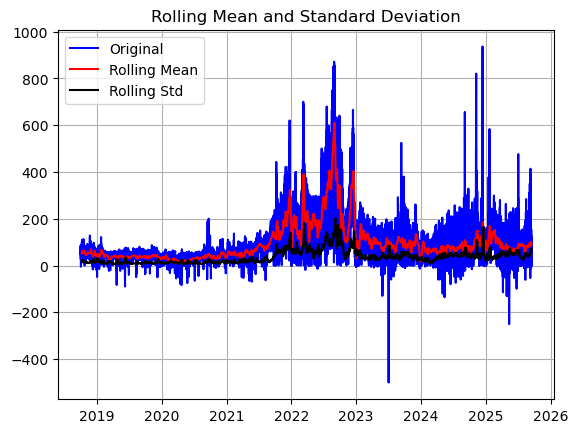

Test Statistic           -4.110969
p-value                   0.000929
Lags Used                 0.000000
Observations Used       362.000000
Critical Value (1%)      -3.448544
Critical Value (5%)      -2.869557
Critical Value (10%)     -2.571041
dtype: float64


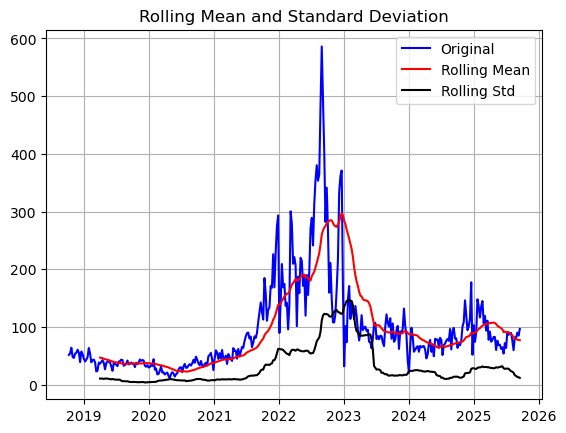

In [7]:
# lets see if data and weekly data have unit roots: adfuller test
df_DE_week = df_DE.resample('W').mean()
import statsmodels.tsa.stattools as ts
def adftest(timeseries : pd.DataFrame, window : int = 12):
    """ perform adfuller test on timeseries and plot rolling statistics 
    
    Args:
        timeseries (pd.DataFrame): a single column of real values and a datetime index
        window (int, optional): window size for rolling statistics. Defaults to 12.
    
    Returns:
        None

    """

    dftest = adfuller(timeseries,)
    dfoutput = pd.Series(dftest[0:4], 
                         index=['Test Statistic','p-value','Lags Used','Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)
    #Determing rolling statistics
    rolmean = timeseries.rolling(window=window).mean()
    rolstd = timeseries.rolling(window=window).std()

    #Plot rolling statistics:
    orig = plt.plot(timeseries, color='blue',label='Original')
    mean = plt.plot(rolmean, color='red', label='Rolling Mean')
    std = plt.plot(rolstd, color='black', label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean and Standard Deviation')
    plt.grid()
    plt.show(block=False)
adftest(df_DE, window = 7*24)
adftest(df_DE_week, window = 26)

# No unit root, but standard deviation correlates with trend. That indicates heteroskedasticity and a (partially) multiplicative error/seasonality.

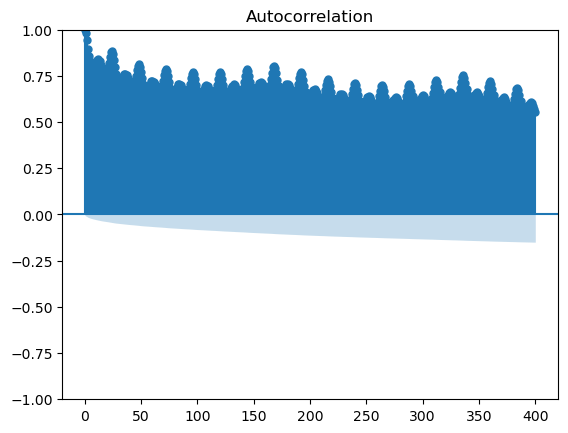

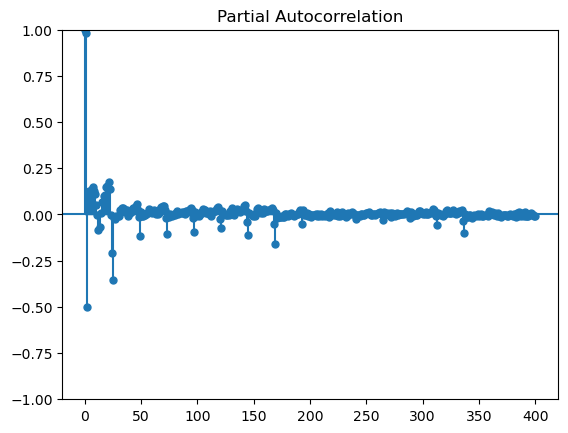

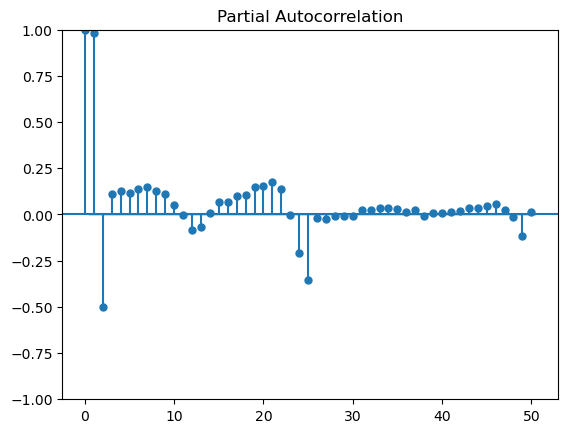

In [8]:
fig_acf = plot_acf(df_DE, lags=400)
fig_acf.show() # we can see that the autocorrelation is large, does decays slowly and shows oscillations. This is a sign of autocorrelation and seasonality.
fig_pacf = plot_pacf(df_DE, lags=400)
fig_pacf.show() # we can see that partial autocorrelation is a thing. Further we see spikes indicating dayly and a weekly pattern.
fig_pacf = plot_pacf(df_DE, lags=50)
fig_pacf.show() # the partial autocorrelation of lag 1 h is very close to one, explains the slow decay of autocorrelation. # the first two lags show very significant partial autocorrelation. Therefore, I expect to need an autocorrealtion parameter p of at least 2.


In [9]:
# lets see the frequencies

# find period of seasonality


df_f_DE, timespan = fourier_analyses(df = df_DE, unit = "h")
df_f_DE.index = df_f_DE.index*24
df_f_DE.index = df_f_DE.index.rename("Freq [1/day]")
df_f_DE.columns = ['Spectral density of prices [€/MWh *h]']
fig = px.scatter(np.abs(df_f_DE.reset_index()), x = 'Freq [1/day]', y = 'Spectral density of prices [€/MWh *h]', log_x=True)
tick_vals = [4,3,2, 1/1 ,2/7, 1/7, 1/30.5, 4/365.24, 1/365.24]
tick_text = ['4/day','3/day','2/day','1/day', '2/week', '1/week', '1/month', '1/quarter', '1/year'] 
# Update x-axis with custom ticks
fig.update_xaxes(
    tickmode='array',
    tickvals=tick_vals,
    ticktext=tick_text,
    showgrid=True  # Show grid lines at tick positions
)

fig.show()
# ok here we can see seasonalities. 
# 1/year is surprisingly small. 
# 1/week, 1/day seem to be genuine seasonalities. 
# The other spikes (like 1/quarter, 2/week,3/day, 4/day) may be harmonic combinations of these frequencies. Harmonics imply partially multiplicative seasonalities. 
#  There is no monthly seasonality.
# the very large values at several low frequencies indicate a long term trend.



Timespan in hours:  60959.0


In [10]:
# stationarize the data. SARIMA will be able to deal with seasonality and some trend, but not with heteroskedasticity. 
# therefore, we go for a log transformation. 
# Ideally, logswould also transform multiplicative seasonalities to additive ones, but since the original has negative values, we have to add offsets and the log does no longer simply turn multiplication to addition.

log_transformer = Transform_For_Variance_Homogenisation(df_DE)
df_DE_log = log_transformer.log_transform()
fig = px.line(df_DE_log) # this is still not homogenous, but it is better
fig.update_layout(title = "Log-transformed prices"
, yaxis_title = "Log-transformed prices ln([€/MWh])")
fig.show()


In [11]:
# multi-seasonal decomposition
# the log transform has hopefully transformed the multiplicative seasonal components into additive and homogenised variance a bit.
log_seaonal_decompose = MSTL(df_DE_log, periods= [int(365.25*24), int(7*24), 24]).fit()

# this takes about 8 min on my machine.

In [12]:
fig = px.line(log_seaonal_decompose.resid, title='Residuals of MSTL decomposed log-transformed data')
fig.show()
fig = px.line(log_seaonal_decompose.trend, title='Trend of MSTL decomposed log-transformed data')
fig.show()
fig = px.line(log_seaonal_decompose.seasonal, title='Seasonal components of MSTL decomposed log-transformed data')
fig.show()

In [13]:
# we notice that residuals are heterosekedastic, with three distinct periods: before mid 2021: low variance,
#  mid 2021-2023: high variance, after mid 2023: medium variance  
# this corresponds with the trend, indicating a multiplicative part
# MSTL allows seasonal components to change slowly over time
# the seasonality for weeks for and days follows the trend pattern, while the yearly seasonality is increasing; possibly due to a strong increase in solar power.

In [14]:
# storing the decomposition in a Recomposer object that allows to recompose the decomposed series and extrapolate/forecast from the decompostion
LogRecomposer = Transform_For_Variance_Homogenisation(df_DE_log)
LogRecomposer.set_trend(log_seaonal_decompose.trend)
LogRecomposer.set_seasonal_decomp(log_seaonal_decompose.seasonal, periods = [int(365.25*24), 7*24,24])

Test Statistic         -1.077647e+01
p-value                 2.312910e-19
Lags Used               5.900000e+01
Observations Used       6.090000e+04
Critical Value (1%)    -3.430457e+00
Critical Value (5%)    -2.861587e+00
Critical Value (10%)   -2.566795e+00
dtype: float64


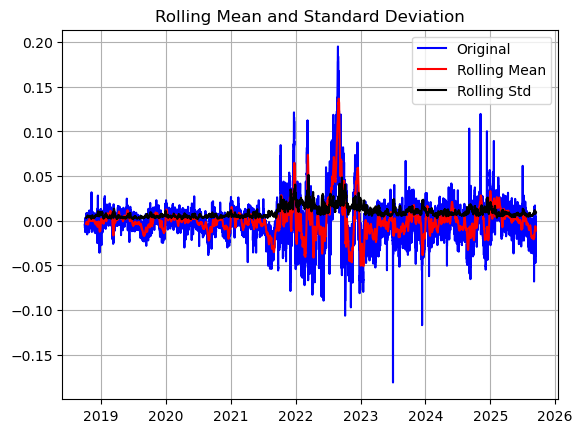

In [15]:

# lets check for unit root
adftest(log_seaonal_decompose.resid, window = 7*24)
# no unit root, rolling standard deviation is much more constant and less correlated with the mean. So less heteroskedasticity and additive error terms.

In [16]:
fig = px.histogram(log_seaonal_decompose.resid)
fig.show() # this is a quite symmetic, quite bell shaped curve, but it is to fat tailed to be normal.

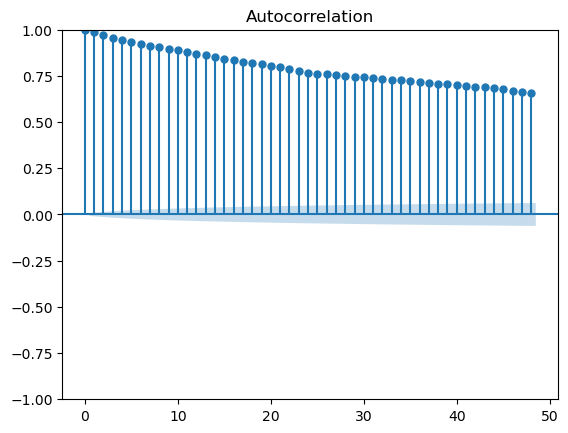

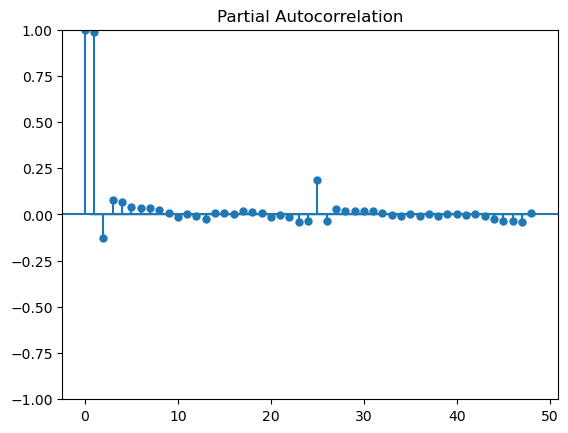

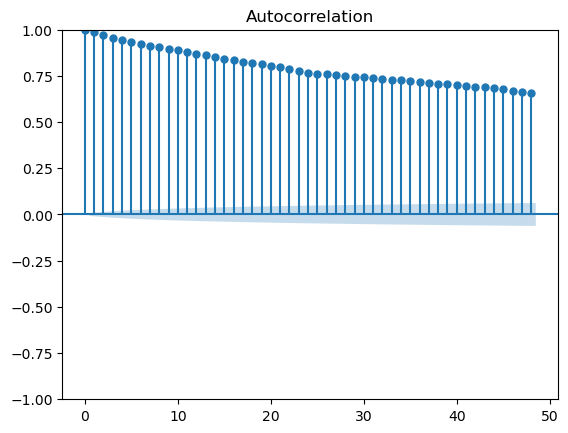

In [17]:
plot_pacf(log_seaonal_decompose.resid) # the first lag autocorr is still close to 1. That is what the adfuller test implied
plot_acf(log_seaonal_decompose.resid) 

In [18]:
# well, I did what I could to statinarise the data for ARIMA. Now let's fit ARIMA
# I will use auto_arima to find the best parameters. 
# Note that the seasonal components have such long lags, that using them will take too much time. The seasonal decompostion should have taken care of them.
# d has to be > 0, because the rolling mean was indicating some trend. d = 1 should suffice
start_training = '2024-09-01'
stepwise_model_2 = pm.auto_arima(log_seaonal_decompose.resid.loc[start_training:], start_p=0, start_q=1,
                           max_p=2, max_q=6, max_d = 2,
                           start_P=0, seasonal=False,
                            trace=True,
                           error_action='ignore',  
                           suppress_warnings=True, 
                           stepwise=True)

Performing stepwise search to minimize aic
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-74923.123, Time=0.37 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-74595.262, Time=0.39 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-74837.916, Time=0.29 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-74597.262, Time=0.12 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-74916.232, Time=63.93 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-75066.043, Time=0.93 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-75356.883, Time=1.16 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-75431.571, Time=2.43 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-75401.514, Time=0.97 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=-75434.835, Time=1.59 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=-75435.054, Time=1.50 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=-75343.315, Time=0.83 sec
 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=-75435.570, Time=1.01 sec
 ARIMA(0,1,4)(0,0,0)[0] intercept   : AIC=-75416.366, Time=1.53 sec
 ARI

In [19]:
stepwise_model_2.summary() # The residuals of our ARIMA model pass the Ljung Box test. So they are no longer correlated. 
# However they are still heteroskedastic and not normally distributed. But since the input is neither, homoskedasticity and normality were improbable.

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                 9072
Model:               SARIMAX(1, 1, 4)   Log Likelihood               37724.784
Date:                Fri, 26 Sep 2025   AIC                         -75437.568
Time:                        09:01:41   BIC                         -75394.891
Sample:                    09-01-2024   HQIC                        -75423.052
                         - 09-13-2025                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4660      0.057      8.216      0.000       0.355       0.577
ma.L1         -0.3138      0.056     -5.585      0.000      -0.424      -0.204
ma.L2         -0.2472      0.011    -23.336      0.000      -0.268      -0.226
ma.L3         -0.0980      0.013     -7.456      0.000      -0.124      -0.072
ma.L4         -0.0070      0.017     -0.416      0.678      -0.040       0.026
sigma2      1.427e-05    7.2e-08    198.092      0.000    1.41e-05    1.44e-05
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):            149237.64
Prob(Q):                              0.99   Prob(JB):                         0.00
Heteroskedasticity (H):               0.75   Skew:                             0.62
Prob(H) (two-sided):                  0.00   Kurtosis:                        22.83
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

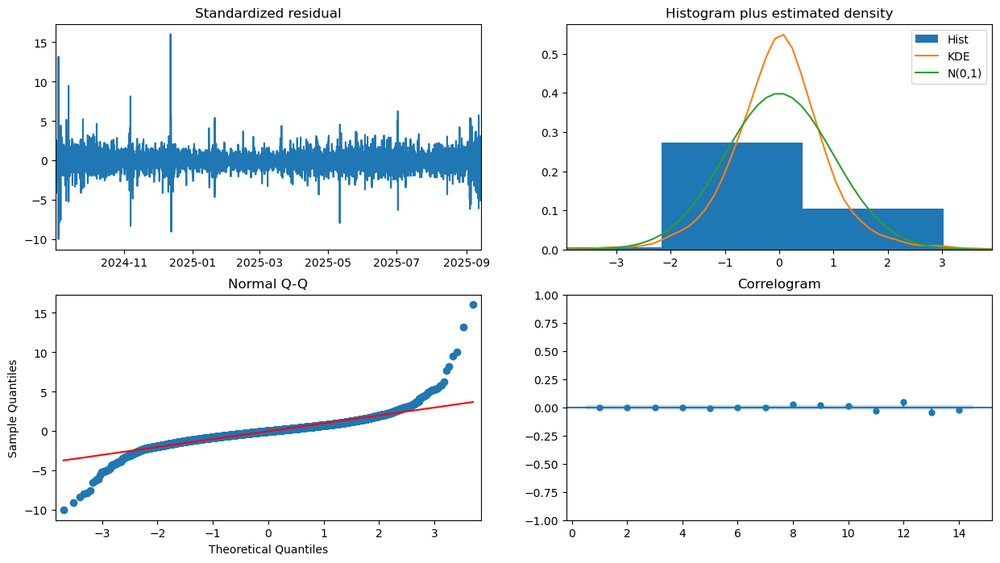

In [20]:
fig = stepwise_model_2.plot_diagnostics(figsize = (15,8),lags = range(1,15))
fig.show()


In [21]:
# the plan is to fit the residuals with an ARIMA model, then (re)construct a prediction by combining ARIMA forecasts with extrapolated seasonalites and trends to yield a final forecast

learning_start = '2024-09-01' # I will shorten the dataset to a) speed up computation and b) reduce exposure the heteroscedasticity induced by past shocks.
horizon = 24 # a forecast horizon of 24 hours seems like the minimum we would need.
forecast_time = 24*(14) + horizon # This gives a forecasted series 14 days long.

df_2309 = log_seaonal_decompose.resid.loc[learning_start:]
start=len(df_2309)-forecast_time-horizon-1
cf_arima = cross_validate(df_2309,horizon,start,1,order = stepwise_model_2.order,seasonal_order = (0,0,0,0),trend=None)
# this takes about 2 minutes per day of forecasting.

# why do I not fit one of the seasonalities in an SARIMA model? I tried. SARIMA gets terribly slow when seasonalities exceed 6 steps. 
# With 24 or even 168 steps we are looking at hours for this cell without real benefit.  

In [22]:
log_residual_forecast = cf_arima['fcst']
#forecast_residuals = ResidTransformer.invert_log_transform(log_residual_forecast)
#forecast_residuals = forecast_residuals- forecast_residuals.iloc[0]
log_residual_forecast = pd.DataFrame(log_residual_forecast)
start=len(df_DE)-forecast_time # the position of the first forecsted value. Note: The position of the last actual value on which the forecast is based is start - horizon. 
log_residual_forecast['Year+Week+Day Log Decompositon'] = 0 # this column will hold the forecast solely based on seasonal decompostion   
log_residual_forecast['ARIMA'] = 0 # this column will hold the forecast based on ARIMA + seasonal decomposition

for i in range(len(log_residual_forecast)):
    log_residual_forecast['Year+Week+Day Log Decompositon'].iloc[i] = LogRecomposer.extrapolate(start+i-horizon, horizon=horizon).iloc[-1] # get the extrapolated values. These are already adjusted to start at the actual value of the time series at the start of the prediction (start - horizon)
    log_residual_forecast['ARIMA'].iloc[i] = (# we add the extrapolated values to the forecasted values to get the final forecast
        log_residual_forecast['fcst'].iloc[i] # the forecasted value of the residiual based on ARIMA
        + LogRecomposer.extrapolate(start+i-horizon, horizon=horizon).iloc[-1] # the value extrapolated from seasonal decompostion (these have alreay been adjusted for residual left out at the start of the prediction)
        - log_seaonal_decompose.resid.iloc[start+i-horizon]) # since we have included a prediction of the residuals we have to remove the residual we included into the seasonal extrapolation.
log_residual_forecast['Year+Week+Day Log Decompositon'] = log_transformer.invert_log_transform(log_residual_forecast['Year+Week+Day Log Decompositon'])
log_residual_forecast['ARIMA'] = log_transformer.invert_log_transform(log_residual_forecast['ARIMA'])

log_residual_forecast = pd.merge(log_residual_forecast,df_DE, left_index=True, right_index=True, how='right') 
fig = px.line(log_residual_forecast, x=log_residual_forecast.index, y=['Price_DE [€/MWh]','Year+Week+Day Log Decompositon','ARIMA']) 
fig.update_layout(xaxis_title='Date', yaxis_title='Price [€/MWh]')
fig.update_xaxes(
    range=[log_residual_forecast.index[start-horizon-3]  , log_residual_forecast.index[-1]],
    rangeslider_visible=True
)
y_min = np.min(log_residual_forecast['Price_DE [€/MWh]'].iloc[start-horizon-3:-1])
y_max = np.max(log_residual_forecast['Price_DE [€/MWh]'].iloc[start-horizon-3:-1])
y_range = y_max - y_min
fig.update_yaxes(
    range = [ y_min- y_range*0.5, y_max+ y_range*0.5],
 #   rangeslider_visible=True
)
fig.show()


In [23]:
results_df = pd.DataFrame(columns=['Forecast_start','horizon','Method','Error'])
# Add a new row
new_row = {
    'Forecast_start': df_DE.index[start],
    'horizon': horizon,
    'Method': 'Year+Week+Day Log Decompositon',
    'Error': rmse(log_residual_forecast.iloc[start:], pred_column='Year+Week+Day Log Decompositon')
}

# Append the new row
results_df = pd.concat([results_df, pd.DataFrame([new_row])], ignore_index=True)
# Add a new row
new_row = {
    'Forecast_start': df_DE.index[start],
    'horizon': horizon,
    'Method': 'Log Seasonal Decomposition + ARIMA (1,1,4)',
    'Error': rmse(log_residual_forecast.iloc[start:], pred_column='ARIMA')
}
results_df = pd.concat([results_df, pd.DataFrame([new_row])], ignore_index=True)

print(results_df) # the ARIMA improves only very slightly over the seasonal decomposition
# why do I use the RMSE of the retransformed values to asses them models? I want to compare to a prophet model, so I need to look at the retransformed values. 
# (Prophet should be able to cope with multiple seasonalites directly). 
# The original values contain a lot of small values which would make mape diverge.
# Lastly, we can interpret rmse directly as the amount our deviations are on average from the true values.
# For a mape like metric, we can compare to the mean of the forecasted values. 
print(np.mean(df_DE.iloc[-forecast_time+horizon:])) # the average price is less than twice the RMSE. The predictions are quite poor.

  Forecast_start horizon                                      Method  \
0     2025-08-30      24              Year+Week+Day Log Decompositon   
1     2025-08-30      24  Log Seasonal Decomposition + ARIMA (1,1,4)   

       Error  
0  45.990803  
1  44.707092  
87.94166666666668


In [24]:
# prophet section


In [25]:
# prophet can use holidays as features. We will use the German holidays as features.
# lets read in German holidays. Source is https://github.com/JasperTN05/Deutschland-Feiertage-Datenbank. I cleaned some duplicates. 

df_holidays = pd.read_csv('deutsche_feiertage_2000_2030.csv', sep=',', parse_dates=['Datum']) 
df_holidays = df_holidays.drop_duplicates()
df_holidays = df_holidays.set_index('Datum') 
df_holidays = df_holidays.drop(columns=['Feiertag', 'Hinweis', 'NATIONAL']) # prophet allows to use different categories of holidays. Germany has different holidays in each Bundesland. So we use the Bundeslaender as categories and can drop the national column.
prophet_holidays = pd.DataFrame()
for col in df_holidays.columns:
    df = pd.DataFrame({
    'holiday': col,
    'ds': df_holidays.loc[df_holidays[col] == 1].index,
    'lower_window': 0,
    'upper_window': 1
    })
    prophet_holidays = pd.concat([prophet_holidays, df])

In [26]:


import logging

logging.getLogger("prophet").setLevel(logging.WARNING)
logging.getLogger("cmdstanpy").disabled=True



In [27]:
# we again reduce the time series to the same ca. 1 year horizon
# this prophet takes about 20 min on my machine
log_residual_forecast['prophet'] = np.nan
df_DE_for_prophet = df_DE.loc[start_training:].reset_index()
df_DE_for_prophet = df_DE_for_prophet.rename(columns={'Date': 'ds', 'Price_DE [€/MWh]': 'y'})
start_shortened_frame = start-len(log_residual_forecast) + len(df_DE_for_prophet)- horizon -1
for i in range(forecast_time+1):
    
    Prophet = prophet.Prophet(holidays=prophet_holidays)#holidays=holidays


    Prophet.fit(df_DE_for_prophet.iloc[:start_shortened_frame+i])#predict(future)
    future = Prophet.make_future_dataframe(periods=horizon, freq='h')
    forecast = Prophet.predict(future)['yhat']
    log_residual_forecast['prophet'].iloc[i+start-1] = forecast.iloc[-1]
    #print(i)

forecast


0        67.670400
1        65.218873
2        60.981103
3        55.466225
4        53.928766
           ...    
9066    105.596080
9067    119.599717
9068    116.142208
9069     99.189702
9070     79.346412
Name: yhat, Length: 9071, dtype: float64

In [28]:
log_residual_forecast

,fcst,Year+Week+Day Log Decompositon,ARIMA,Price_DE [€/MWh],prophet
Date,,,,,
2018-10-01 00:00:00,NaN,NaN,NaN,59.53,NaN
2018-10-01 01:00:00,NaN,NaN,NaN,56.10,NaN
2018-10-01 02:00:00,NaN,NaN,NaN,51.41,NaN
2018-10-01 03:00:00,NaN,NaN,NaN,47.38,NaN
2018-10-01 04:00:00,NaN,NaN,NaN,47.59,NaN
...,...,...,...,...,...
2025-09-13 19:00:00,-0.016841,143.015468,131.083485,121.90,105.570188
2025-09-13 20:00:00,-0.014983,94.875791,98.324722,118.77,119.553645
2025-09-13 21:00:00,-0.018052,93.138446,89.558926,111.17,116.248712


In [29]:
fig = px.line(log_residual_forecast.reset_index() , x='Date', y=['Price_DE [€/MWh]','Year+Week+Day Log Decompositon','ARIMA','prophet']) 
fig.update_layout(xaxis_title='Date', yaxis_title='Price [€/MWh]')
fig.update_xaxes(
    range=[log_residual_forecast.index[start-horizon-3]  , log_residual_forecast.index[-1]],
    rangeslider_visible=True
)
y_min = np.min(log_residual_forecast['Price_DE [€/MWh]'].iloc[start-horizon-3:-1])
y_max = np.max(log_residual_forecast['Price_DE [€/MWh]'].iloc[start-horizon-3:-1])
y_range = y_max - y_min
fig.update_yaxes(
    range = [ y_min- y_range*0.25, y_max+ y_range*0.25],
 #   rangeslider_visible=True
)
fig.show()
# the prophet is rather underwhelming. It seems to be a very simplistic seasonal extrapolation. However, the two models exptrapolating from past data tend to repeat the previous day, even if that day was quite extreme. 

In [30]:
new_row = {
    'Forecast_start': df_DE.index[start],
    'horizon': horizon,
    'Method': 'Prophet',
    'Error': rmse(log_residual_forecast.iloc[start:], pred_column='prophet')
}
results_df = pd.concat([results_df, pd.DataFrame([new_row])], ignore_index=True)
results_df = results_df.drop_duplicates()

In [31]:
results_df # the prophet is slightly worse than the decompostion models. ARIMA is best, but not by very much compared to simple decompositon.

,Forecast_start,horizon,Method,Error
0,2025-08-30,24,Year+Week+Day Log Decompositon,45.990803
1,2025-08-30,24,"Log Seasonal Decomposition + ARIMA (1,1,4)",44.707092
2,2025-08-30,24,Prophet,47.970345


In [32]:
df_DE.loc[start_training:, 'Price_DE [€/MWh]'].describe()
df_DE.iloc[-336:].describe()

,Price_DE [€/MWh]
count,336.000000
mean,87.941667
std,62.057973
min,-53.400000
25%,65.262500
50%,87.815000
75%,110.380000
max,413.660000


In [33]:
# discussion of results:
# All models generate somewhat useful predictions. 
# log transforemed multi-seasonally decomposed ARIMA is the best model,
# followed by the merely log-transformed multi-seasonal decomposition and lastly the prophet.
# however, differences between models span hardly 5 €/MWh, while the best model is still on average about 40 €/MWh off.
# To truly overcome this issue, I would need to incorporate external data, especially weather forecasts.
# This is beyond the scope of this project. - For now.

